In [1]:
import sys
#sys.path.append('/home/maria/Documents/projects/avs7_mainproject/')
sys.path.append('/home/maria/Documents/projects/pad_visual/')

In [2]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

from data.agco_dataloader import *
from utils.visualization import *
from model.poisson_blending import *


In [3]:
PATH_PATCHES = '/home/maria/Documents/datasets/pad_images/Google_Pixel7/' #Google_Pixel7, Samsung, SamsungA50
AGCO_DATA_DIR = '/home/maria/Documents/dataset_splited/normal/front'
NEW_SIZE = 256

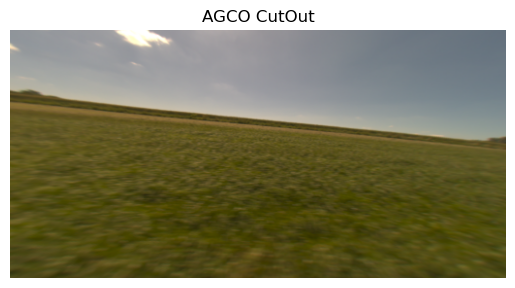

In [4]:
agco_image = read_agco(data_dir=AGCO_DATA_DIR, resize=(NEW_SIZE*2, NEW_SIZE), path_image='/home/maria/Documents/dataset_splited/normal/front/BNV61080I3001136_cam_lucid_490_image_raw_2024_06_25_13_37_45_2.png')
plt.axis('off')
plt.title('AGCO CutOut')
plt.imshow(agco_image)

In [5]:
def resize_to_destination(image, mask, dest_image):
    dest_height, dest_width = dest_image.shape[:2]

    resized_image = cv2.resize(image, (dest_width, dest_height), interpolation=cv2.INTER_LINEAR)

    resized_mask = cv2.resize(mask, (dest_width, dest_height), interpolation=cv2.INTER_NEAREST)

    return resized_image, resized_mask

def close_box_object_mask(ima_dest, src_image, object_mask):
    
    dims = np.array(ima_dest.shape[:2]) 
    
    y_indices, x_indices = np.where(object_mask > 0)
    if len(y_indices) == 0 or len(x_indices) == 0:
        print("No object found in the mask.")
        return ima_dest.copy(), ((0, 0), (0, 0)), None

    y1 = y_indices.min()
    y2 = y_indices.max() + 1  
    x1 = x_indices.min()
    x2 = x_indices.max() + 1  

    return ((y1, x1), (y2, x2)), object_mask[y1:y2, x1:x2], src_image[y1:y2, x1:x2]

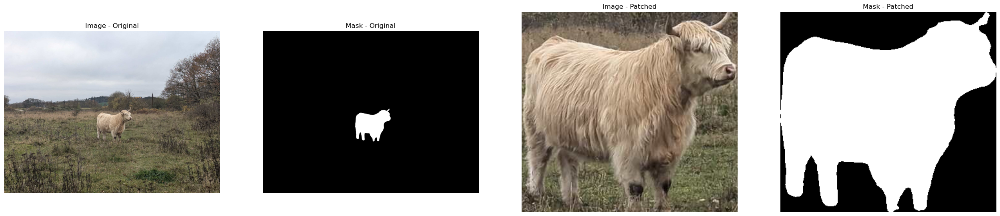

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (312, 335) (312, 335, 3) (256, 512, 3) (256, 512)


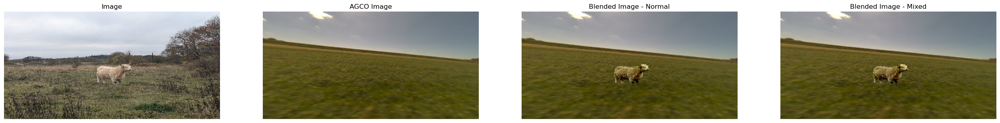

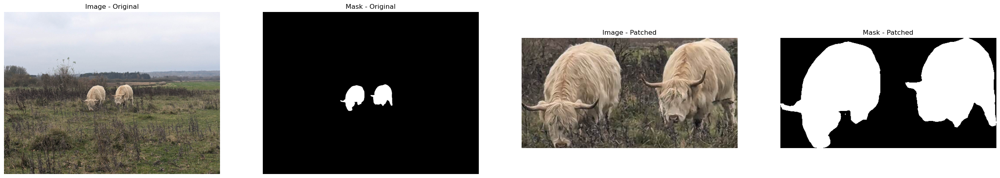

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (252, 493) (252, 493, 3) (256, 512, 3) (256, 512)


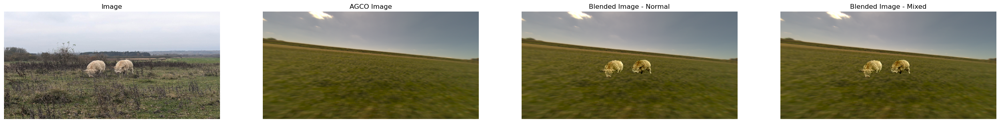

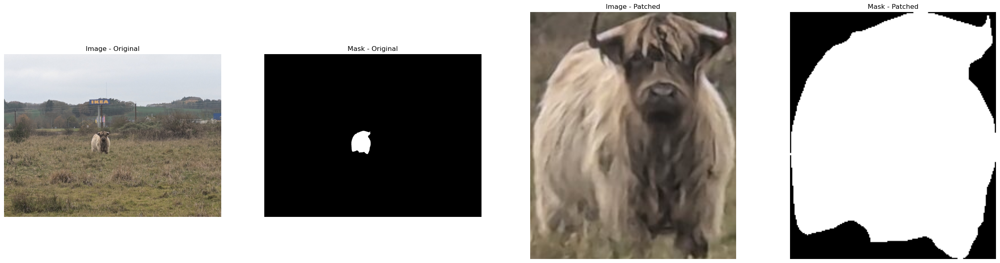

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (219, 182) (219, 182, 3) (256, 512, 3) (256, 512)


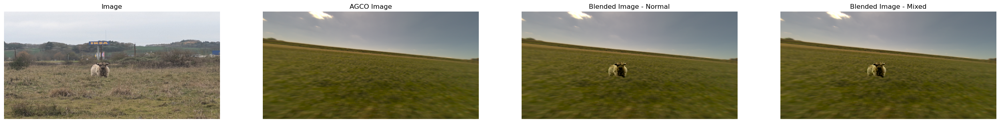

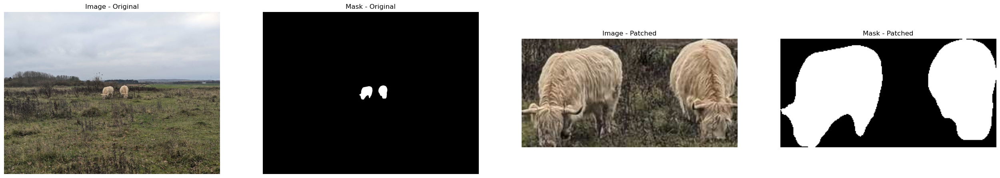

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (134, 266) (134, 266, 3) (256, 512, 3) (256, 512)


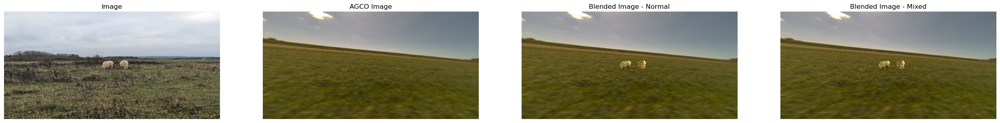

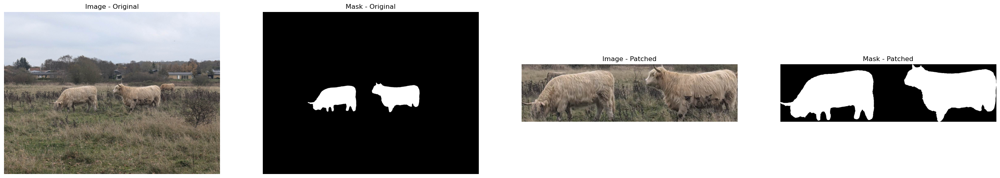

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (283, 1056) (283, 1056, 3) (256, 512, 3) (256, 512)


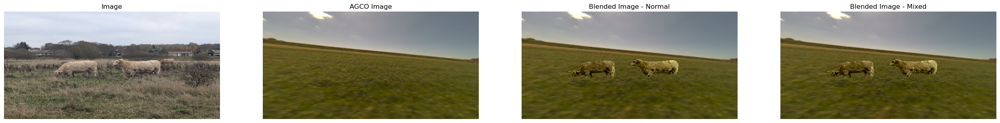

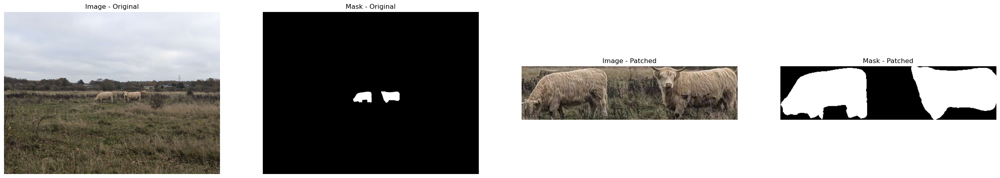

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (110, 441) (110, 441, 3) (256, 512, 3) (256, 512)


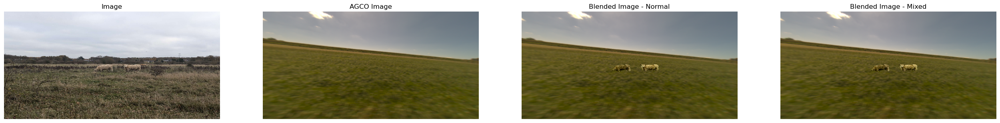

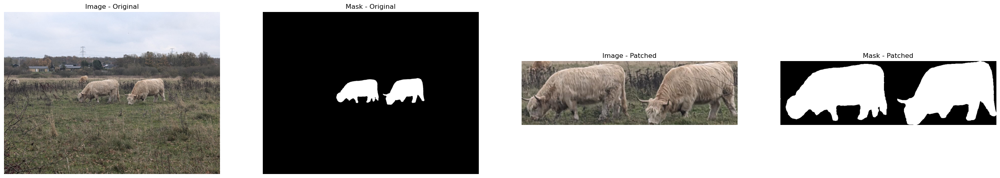

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (252, 853) (252, 853, 3) (256, 512, 3) (256, 512)


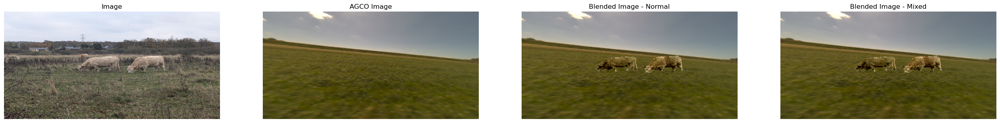

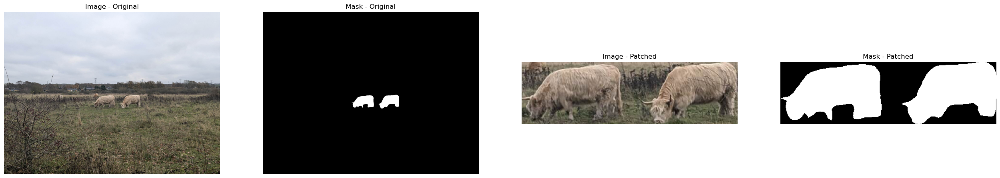

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (130, 450) (130, 450, 3) (256, 512, 3) (256, 512)


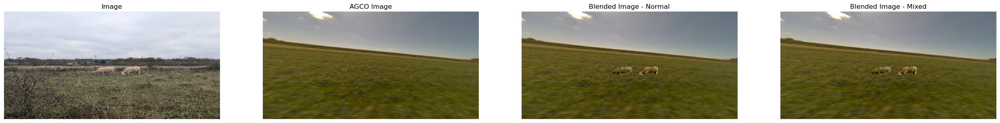

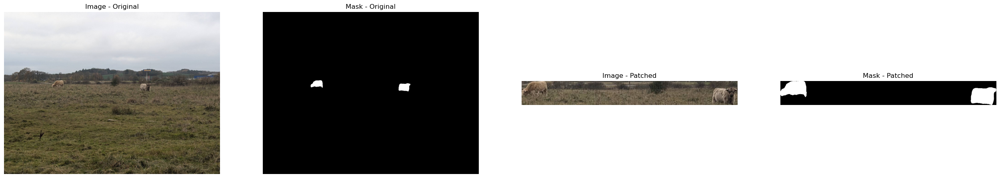

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (106, 942) (106, 942, 3) (256, 512, 3) (256, 512)


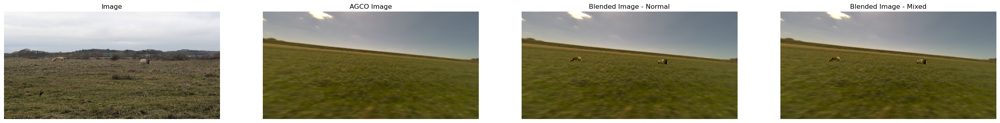

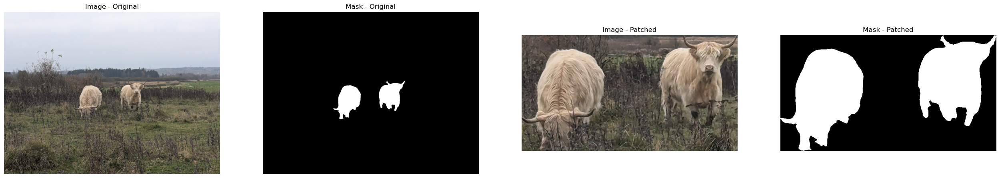

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (365, 677) (365, 677, 3) (256, 512, 3) (256, 512)


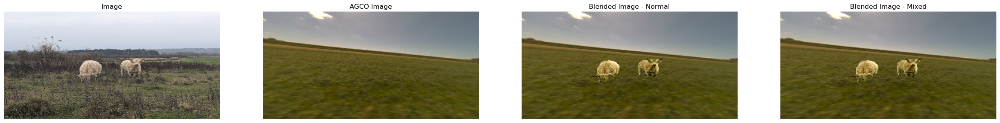

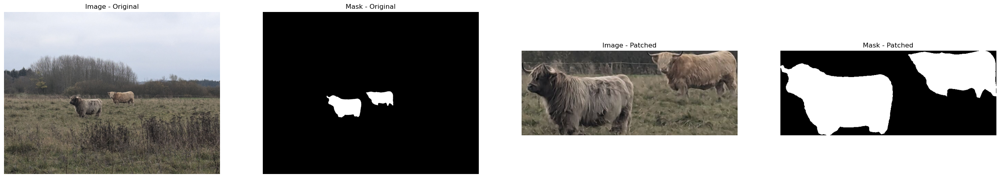

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (247, 630) (247, 630, 3) (256, 512, 3) (256, 512)


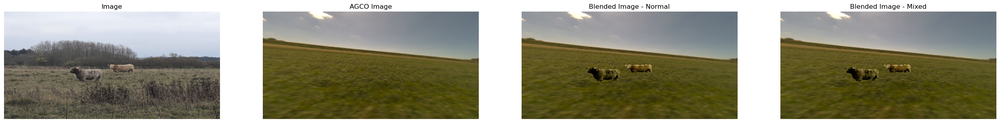

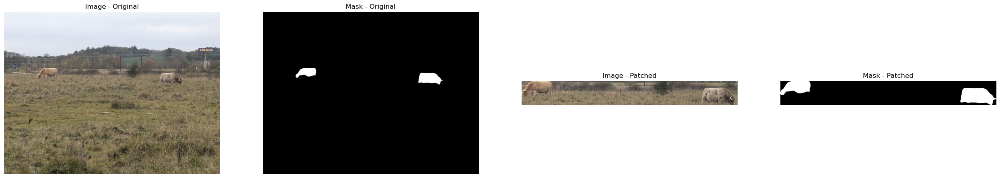

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (157, 1391) (157, 1391, 3) (256, 512, 3) (256, 512)


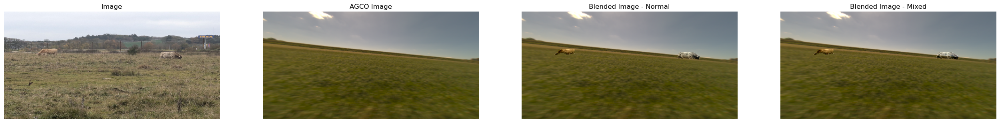

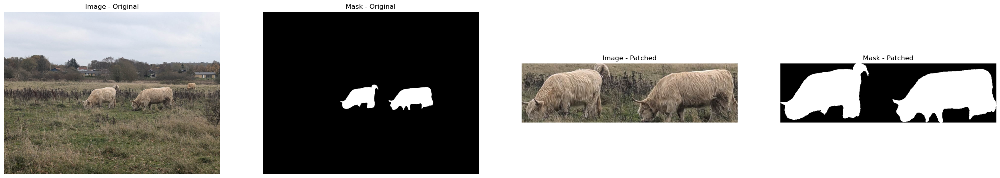

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (242, 878) (242, 878, 3) (256, 512, 3) (256, 512)


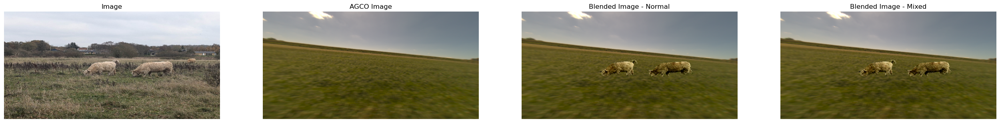

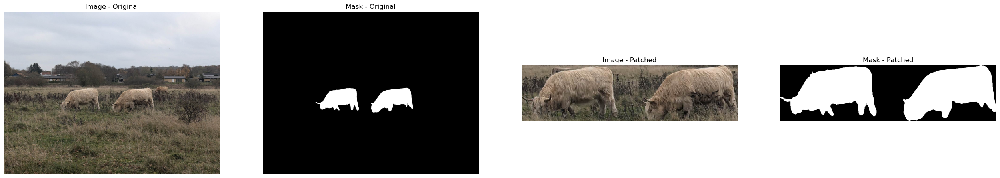

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (235, 923) (235, 923, 3) (256, 512, 3) (256, 512)


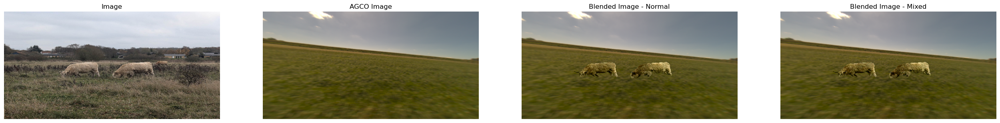

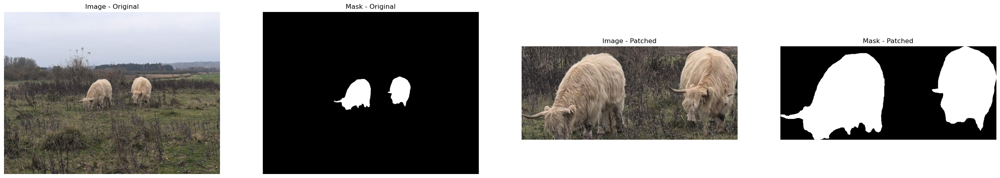

(256, 512, 3) (1536, 2040, 3) (1536, 2040) (315, 726) (315, 726, 3) (256, 512, 3) (256, 512)


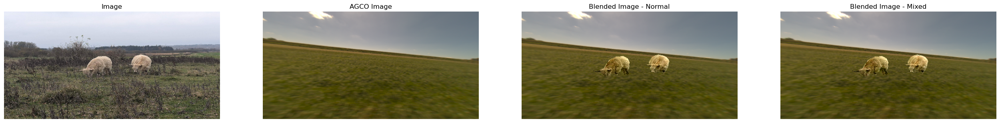

In [6]:
allfiles = os.listdir(PATH_PATCHES+'Cow/')

images = [fname for fname in allfiles if fname.endswith('.jpg')]
masks = [fname for fname in allfiles if fname.endswith('.png')]

for image_fname in images:

    image_path = os.path.join(PATH_PATCHES+'Cow/', image_fname)
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  
    
    mask_fname = image_fname.replace('.jpg', '.png')
    mask_path = os.path.join(PATH_PATCHES+'Cow/', mask_fname)

    mask = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)

    ((y1, x1), (y2, x2)), patched_mask, patched_coco = close_box_object_mask(ima_dest=agco_image, src_image=image, object_mask=mask)

    display_images_side_by_side(images=[image, mask, patched_coco, patched_mask], titles=['Image - Original', 'Mask - Original', 'Image - Patched', 'Mask - Patched'], config_cmap=[None, 'grey', None, 'grey'])

    resized_image, resized_mask = resize_to_destination(image=image, mask=mask, dest_image=agco_image)

    print(agco_image.shape, image.shape, mask.shape, patched_mask.shape, patched_coco.shape, resized_image.shape, resized_mask.shape)

    blend_img_normal_black = np.zeros(agco_image.shape)
    blend_img_mixed_black = np.zeros(agco_image.shape)
    for channel in range(len('RGB')):
        blend_img_normal_black[:,:,channel] = compute_poisson_blend_channel(resized_image[:,:,channel]*1.3/255., agco_image[:,:,channel]/255., resized_mask/255., 'normal')
        blend_img_mixed_black[:,:,channel] = compute_poisson_blend_channel(resized_image[:,:,channel]*1.3/255., agco_image[:,:,channel]/255., resized_mask/255., 'mixed')
    
    display_images_side_by_side(images=[resized_image, agco_image, blend_img_normal_black, blend_img_mixed_black], titles=['Image', 'AGCO Image', 'Blended Image - Normal', 'Blended Image - Mixed'], config_cmap=[None, None, None, None])

    plt.imsave(f"{PATH_PATCHES}Synthetic/{image_fname[:-4]}_normal.png", blend_img_normal_black)
    plt.imsave(f"{PATH_PATCHES}Synthetic/{image_fname[:-4]}_mixed.png", blend_img_mixed_black)